# Noising Experiments
In this notebook i will:
1. Insert noise (with different parameters, if applicable) in a default image (colored noise k = 6)
2. Extract the metrics of the noised images with different parameters
3. Generate the curve that represents the noise used
4. Insert noise on images of the dataset and see if it gets near the curve generated at step 3

## Periodic

In [1]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import cv2
import os
from PIL import Image
from utils.images_generator import periodic_noise, normalize_img_to_0_255, generate_histogram, colored_noise, uniform_image
from utils.experiments_functions import get_img_info
from skimage import data
from skimage.color import rgb2gray

### Default Image

Generating default image

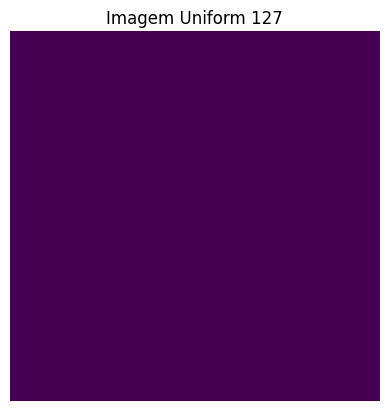

(122, 122)


In [2]:
# generates the default image (uniform)
gs_image = uniform_image(127, (122, 122))
plt.imshow(gs_image)
plt.title(f"Imagem Uniform 127")
plt.axis('off')  # Remove os eixos
plt.show()
print(gs_image.shape)

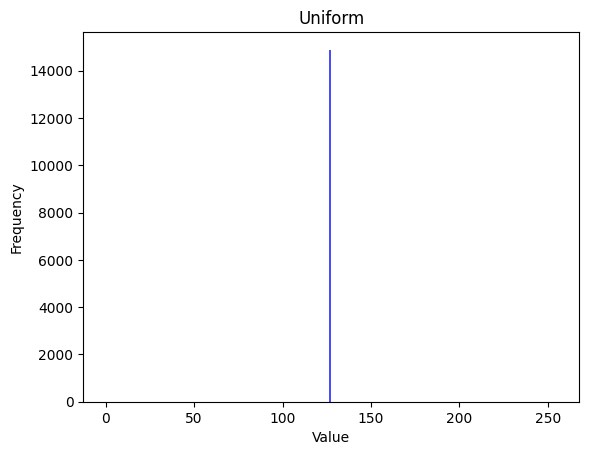

In [3]:
generate_histogram(gs_image, isNormalized=True, title=f'Uniform')

c:\Users\Alvaro\Documents\1 - MESTRADO\Estudo dirigido\SCS_plane_study\utils\images_generator.py:50: RuntimeWarning: divide by zero encountered in divide
  y_2 = y / f**(k/2)
c:\Users\Alvaro\Documents\1 - MESTRADO\Estudo dirigido\SCS_plane_study\utils\images_generator.py:50: RuntimeWarning: invalid value encountered in divide
  y_2 = y / f**(k/2)


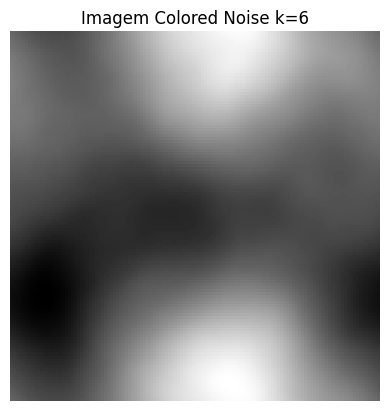

(122, 122)


In [2]:
# generates the default image (colored noise k=6)
gs_image = colored_noise(6, (122, 122))
# normalize to 0-255
gs_image = normalize_img_to_0_255(gs_image)
plt.imshow(gs_image, cmap='gray')
plt.title(f"Imagem Colored Noise k=6")
plt.axis('off')  # Remove os eixos
plt.show()
print(gs_image.shape)

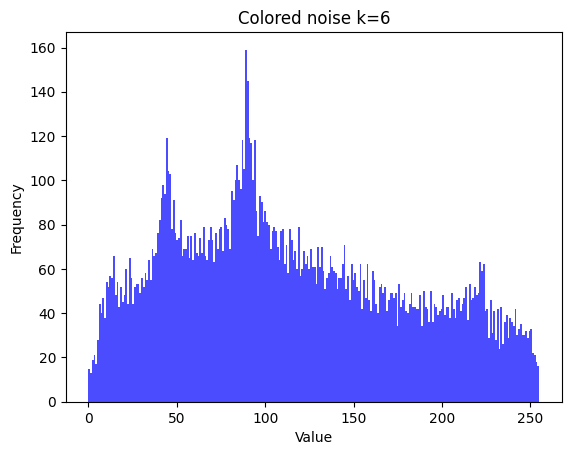

In [16]:
generate_histogram(gs_image, isNormalized=True, title=f'Colored noise k=6')

Generating the noised images

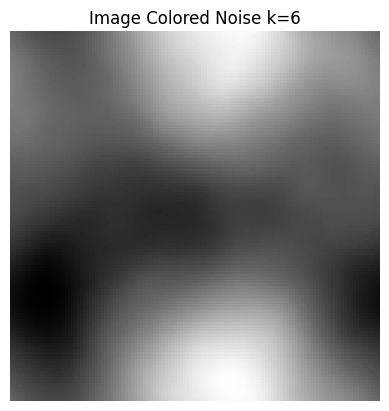

(122, 122)


In [3]:
freq_x = 0
freq_y = 0
amp = 0
noised_image = periodic_noise(freq_x, freq_y, amp, gs_image)
plt.imshow(noised_image, cmap='gray')
plt.title(f"Image Colored Noise k=6")
plt.axis('off')
plt.show()
print(noised_image.shape)

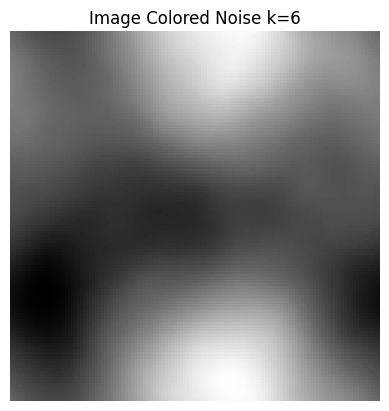

(122, 122)


In [4]:
freq_x = 5
freq_y = 5
amp = 0
noised_image = periodic_noise(freq_x, freq_y, amp, gs_image)
plt.imshow(noised_image, cmap='gray')
plt.title(f"Image Colored Noise k=6")
plt.axis('off')
plt.show()
print(noised_image.shape)

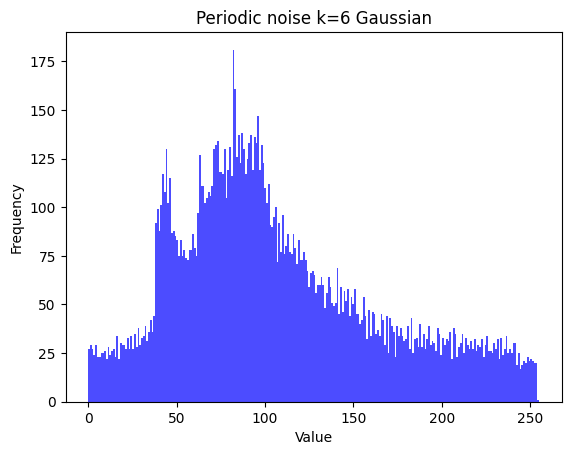

In [5]:
generate_histogram(noised_image, isNormalized=True, title=f'Periodic noise k=6 Gaussian')

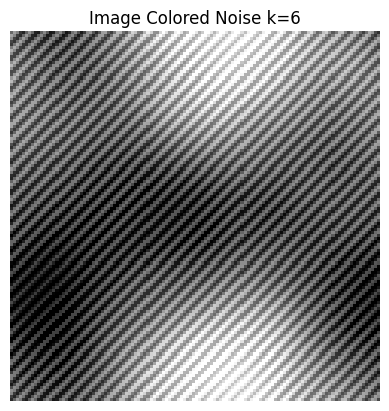

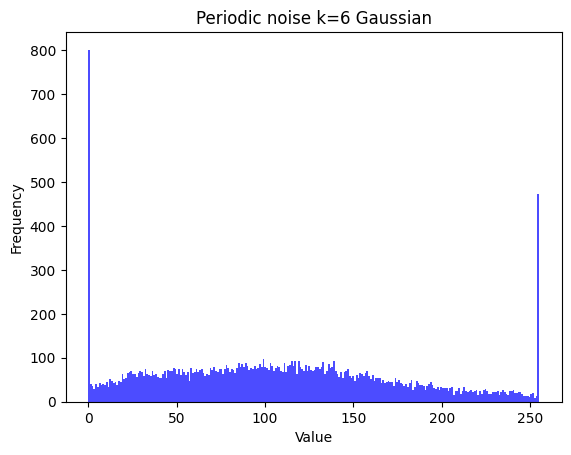

In [14]:
freq_x = 25
freq_y = 25
amp = 60
noised_image = periodic_noise(freq_x, freq_y, amp, gs_image)
plt.imshow(noised_image, cmap='gray')
plt.title(f"Image Colored Noise k=6")
plt.axis('off')
plt.show()
generate_histogram(noised_image, isNormalized=True, title=f'Periodic noise k=6 Gaussian')

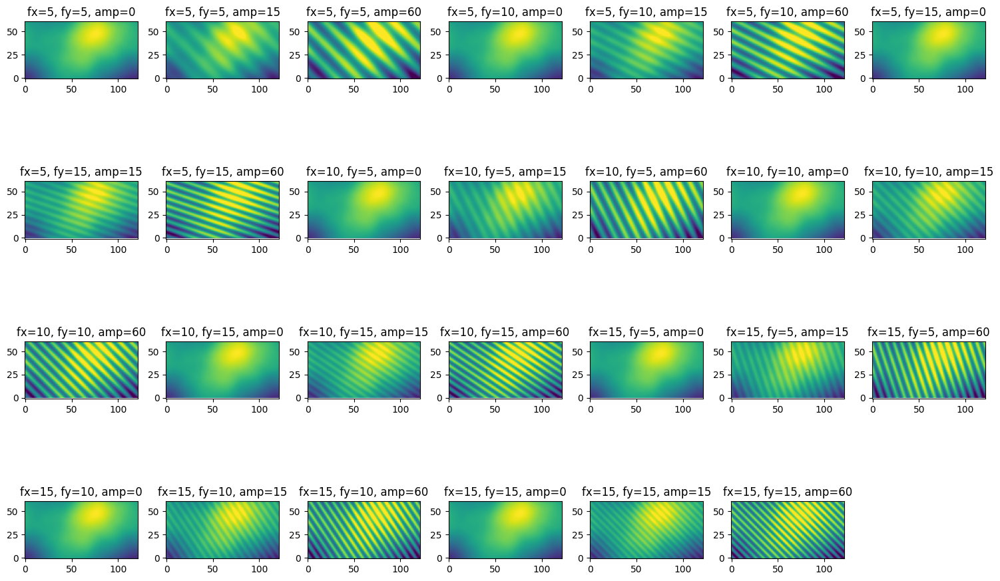

In [72]:

import itertools

# sets the probabilities used
freq_values = [5, 10, 15]
amp_values = [0, 15, 60]

combinations = list(itertools.product(freq_values, freq_values, amp_values))
# Calculate the number of subplots needed
num_combinations = len(combinations)
rows = 4  # You can adjust the number of rows based on your preference
cols = (num_combinations + rows - 1) // rows  # Calculate required number of columns

# Create the subplots
fig, axs = plt.subplots(rows, cols, figsize=(15, 10))
axs = axs.flatten()  # Flatten the axes array to iterate easily

# Plot each combination in a subplot
for i, (a, b, c) in enumerate(combinations):
    noised_image = periodic_noise(a, b, c, gs_image)
    axs[i].imshow(noised_image)  # Example plot, modify as needed
    axs[i].set_title(f"fx={a}, fy={b}, amp={c}")
    axs[i].set_ylim([min(freq_values + freq_values + amp_values) - 1, max(freq_values + freq_values + amp_values) + 1])

# Remove any empty subplots (if any)
for j in range(i + 1, len(axs)):
    fig.delaxes(axs[j])

plt.tight_layout()
plt.show()

In [ ]:
# sets the default images 
default_images = {
    'colored_k6':normalize_img_to_0_255(colored_noise(6, (122, 122))),
    'uniform 127':uniform_image(127, (122, 122))
}
# sets the probabilities used
freq_values = [5, 10, 15]
amp_values = [0, 15, 60]
# stores all the metrics of each image in a list
image_data_list = []
for gs_image_name in default_images:
    gs_image = default_images[gs_image_name]
    for fx_value in freq_values:
        for fy_value in freq_values:
            for amp_value in amp_values:
                # if amp_value == 0, just run it once
                if (amp_value == 0) and not ((fx_value == 5) and (fy_value == 5)):
                    continue
                print(f"fx = {fx_value}")
                print(f"fy = {fy_value}")
                print(f"amp = {amp_value}")
                # generate noise image
                print("Generating noised image")
                noised_image = periodic_noise(fx_value, fy_value, amp_value, gs_image)
                # extract metrics
                print("Extracting data")
                noised_image_data = get_img_info(noised_image, q_linspace = np.linspace(-2, 20, num = 23))
                # add the information
                noised_image_data['image_name'] = gs_image_name
                noised_image_data['fx_value'] = fx_value
                noised_image_data['fy_value'] = fy_value
                noised_image_data['amp_value'] = amp_value
                image_data_list.append(noised_image_data)

New experiments

In [51]:
# sets the default images 
default_images = {
    'colored_k6':normalize_img_to_0_255(colored_noise(6, (122, 122))),
    'uniform 127':uniform_image(127, (122, 122))
}
# sets the probabilities used
freq_values = [5, 10, 15]
amp_values = [0, 15, 60]
freq_values = [0, 10, 20, 30, 40]
amp_values = [0, 20, 40, 60, 80, 100]
exp_values = { # amp, fx, fy
    'no_noise': ([0], [0], [0]),
    'amp': (amp_values, [5], [5]), # experiments with amplitude,
    'fx': ([40], freq_values, [5]), # experiments with frequency
    'fy': ([40], [5], freq_values), # experiments with frequency
}
q_space = np.linspace(-2, 20, num = 23)
q_space = [0]
# stores all the metrics of each image in a list
image_data_list = []
for gs_image_name in default_images:
    # reads the image    
    gs_image = default_images[gs_image_name]
    # adds noise
    for categ in exp_values:
        amp_exp, fx_exp, fy_exp = exp_values[categ]
        for fx_value in fx_exp:
            for fy_value in fy_exp:
                for amp_value in amp_exp:
                    print(f"fx = {fx_value}")
                    print(f"fy = {fy_value}")
                    print(f"amp = {amp_value}")
                    # generate noise image
                    print("Generating noised image")
                    noised_image = periodic_noise(fx_value, fy_value, amp_value, gs_image)
                    # extract metrics
                    print("Extracting data")
                    noised_image_data = get_img_info(noised_image, q_linspace = q_space)
                    # add the information
                    noised_image_data['image_name'] = gs_image_name
                    noised_image_data['fx_value'] = fx_value
                    noised_image_data['fy_value'] = fy_value
                    noised_image_data['amp_value'] = amp_value
                    image_data_list.append(noised_image_data)


c:\Users\Alvaro\Documents\1 - MESTRADO\Estudo dirigido\SCS_plane_study\utils\images_generator.py:50: RuntimeWarning: divide by zero encountered in divide
  y_2 = y / f**(k/2)
c:\Users\Alvaro\Documents\1 - MESTRADO\Estudo dirigido\SCS_plane_study\utils\images_generator.py:50: RuntimeWarning: invalid value encountered in divide
  y_2 = y / f**(k/2)


fx = 0
fy = 0
amp = 0
Generating noised image
Extracting data
fx = 5
fy = 5
amp = 0
Generating noised image
Extracting data
fx = 5
fy = 5
amp = 20
Generating noised image
Extracting data
fx = 5
fy = 5
amp = 40
Generating noised image
Extracting data
fx = 5
fy = 5
amp = 60
Generating noised image
Extracting data
fx = 5
fy = 5
amp = 80
Generating noised image
Extracting data
fx = 5
fy = 5
amp = 100
Generating noised image
Extracting data
fx = 0
fy = 5
amp = 40
Generating noised image
Extracting data
fx = 10
fy = 5
amp = 40
Generating noised image
Extracting data
fx = 20
fy = 5
amp = 40
Generating noised image
Extracting data
fx = 30
fy = 5
amp = 40
Generating noised image
Extracting data
fx = 40
fy = 5
amp = 40
Generating noised image
Extracting data
fx = 5
fy = 0
amp = 40
Generating noised image
Extracting data
fx = 5
fy = 10
amp = 40
Generating noised image
Extracting data
fx = 5
fy = 20
amp = 40
Generating noised image
Extracting data
fx = 5
fy = 30
amp = 40
Generating noised image
Ex

In [53]:
data_default_aux = pd.concat(image_data_list, ignore_index=True)

In [54]:
data_default_aux.to_csv(f"results/noise_analysis/periodic/periodic_analysis_default_V2.csv", index = False)

### Dataset Images
1. Take 1 image from each of the 25 classes of the Sintorn Dataset
2. Insert noise with different probabilities
3. extract metrics and insert in the previous dataframe

In [48]:
# reads 1 image from each class
images_path = f'data/Sintorn/hardware'
rot = 'r000'
seg = 's001'
images_filenames = []
for file in os.listdir(images_path):
    if file.endswith(f"{rot}-{seg}.png"):
        images_filenames.append(file)
print(images_filenames)

['canesugar01-r000-s001.png', 'canvas01-r000-s001.png', 'couscous01-r000-s001.png', 'fabric01-r000-s001.png', 'fabric02-r000-s001.png', 'fabric03-r000-s001.png', 'fabric04-r000-s001.png', 'fabric05-r000-s001.png', 'flaxseed01-r000-s001.png', 'knitwear01-r000-s001.png', 'knitwear02-r000-s001.png', 'knitwear03-r000-s001.png', 'lentils01-r000-s001.png', 'oatmeal01-r000-s001.png', 'pearlsugar01-r000-s001.png', 'rice01-r000-s001.png', 'rug01-r000-s001.png', 'ryeflakes01-r000-s001.png', 'seeds01-r000-s001.png', 'seeds02-r000-s001.png', 'sprinkles01-r000-s001.png', 'tile01-r000-s001.png', 'towel01-r000-s001.png', 'wheat01-r000-s001.png', 'wool01-r000-s001.png']


Testing histogram

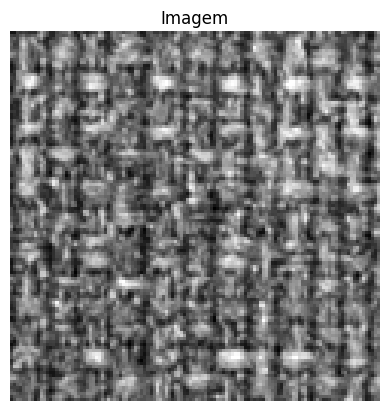

(122, 122)


In [45]:
img_filename = images_filenames[3]
gs_image = cv2.imread(f'{images_path}/{img_filename}', cv2.IMREAD_GRAYSCALE)
plt.imshow(gs_image, cmap='gray')
plt.title(f"Imagem")
plt.axis('off')  # Remove os eixos
plt.show()
print(gs_image.shape)

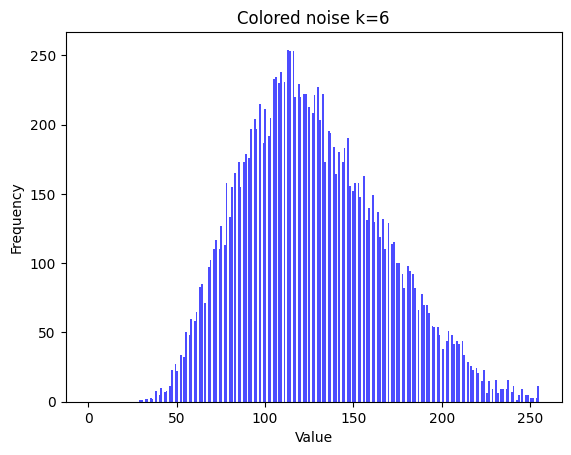

In [18]:
generate_histogram(gs_image, isNormalized=True, title=f'Colored noise k=6')

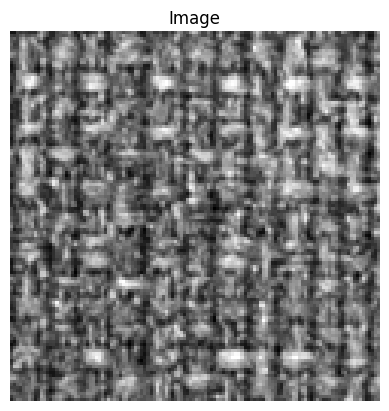

(122, 122)


In [43]:
freq_x = 0
freq_y = 0
amp = 0
noised_image = periodic_noise(freq_x, freq_y, amp, gs_image)
plt.imshow(noised_image, cmap='gray')
plt.title(f"Image")
plt.axis('off')
plt.show()
print(noised_image.shape)

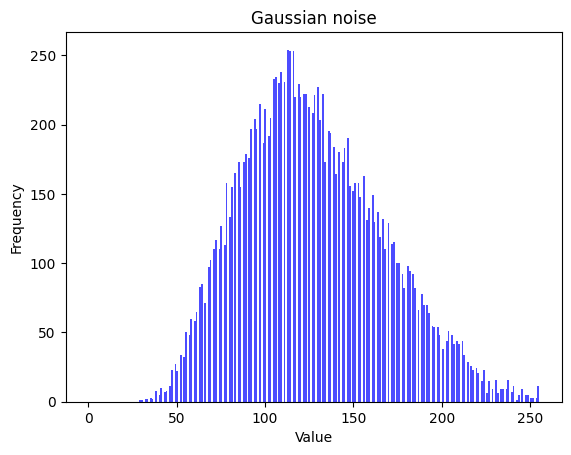

In [44]:
generate_histogram(noised_image, isNormalized=True, title=f'Gaussian noise')

Extracting metrics for each image with each parameter

In [ ]:
# sets the probabilities used
freq_values = [5, 10, 15]
amp_values = [0, 15, 60]
freq_values = [0, 10, 20, 30, 40]
amp_values = [0, 20, 40, 60, 80, 100]
q_space = np.linspace(-2, 20, num = 23)
q_space = [0]
# stores all the metrics of each image in a list
image_data_list = []
for idx, img_filename in enumerate(images_filenames):
    # reads the image
    gs_image = cv2.imread(f'{images_path}/{img_filename}', cv2.IMREAD_GRAYSCALE)
    image_title = img_filename.split('.')[0]
    print(image_title, f"{idx+1}/{len(images_filenames)}")
    # adds noise
    for fx_value in freq_values:
        for fy_value in freq_values:
            for amp_value in amp_values:
                # if amp_value == 0, just run it once
                if (amp_value == 0) and not ((fx_value == 5) and (fy_value == 5)):
                    continue
                print(f"fx = {fx_value}")
                print(f"fy = {fy_value}")
                print(f"amp = {amp_value}")
                # generate noise image
                print("Generating noised image")
                noised_image = periodic_noise(fx_value, fy_value, amp_value, gs_image)
                # extract metrics
                print("Extracting data")
                noised_image_data = get_img_info(noised_image, q_linspace = q_space)
                # add the information
                noised_image_data['image_name'] = img_filename
                noised_image_data['fx_value'] = fx_value
                noised_image_data['fy_value'] = fy_value
                noised_image_data['amp_value'] = amp_value
                image_data_list.append(noised_image_data)


In [49]:
# sets the probabilities used
freq_values = [5, 10, 15]
amp_values = [0, 15, 60]
freq_values = [0, 10, 20, 30, 40]
amp_values = [0, 20, 40, 60, 80, 100]
exp_values = { # amp, fx, fy
    'no_noise': ([0], [0], [0]),
    'amp': (amp_values, [5], [5]), # experiments with amplitude,
    'fx': ([40], freq_values, [5]), # experiments with frequency
    'fy': ([40], [5], freq_values), # experiments with frequency
}
q_space = np.linspace(-2, 20, num = 23)
q_space = [0]
# stores all the metrics of each image in a list
image_data_list = []
images_filenames = ['couscous01-r000-s001.png','lentils01-r000-s001.png','sprinkles01-r000-s001.png','towel01-r000-s001.png']
for idx, img_filename in enumerate(images_filenames):
    # reads the image
    gs_image = cv2.imread(f'{images_path}/{img_filename}', cv2.IMREAD_GRAYSCALE)
    image_title = img_filename.split('.')[0]
    print(image_title, f"{idx+1}/{len(images_filenames)}")
    # adds noise
    for categ in exp_values:
        amp_exp, fx_exp, fy_exp = exp_values[categ]
        for fx_value in fx_exp:
            for fy_value in fy_exp:
                for amp_value in amp_exp:
                    print(f"fx = {fx_value}")
                    print(f"fy = {fy_value}")
                    print(f"amp = {amp_value}")
                    # generate noise image
                    print("Generating noised image")
                    noised_image = periodic_noise(fx_value, fy_value, amp_value, gs_image)
                    # extract metrics
                    print("Extracting data")
                    noised_image_data = get_img_info(noised_image, q_linspace = q_space)
                    # add the information
                    noised_image_data['image_name'] = img_filename
                    noised_image_data['fx_value'] = fx_value
                    noised_image_data['fy_value'] = fy_value
                    noised_image_data['amp_value'] = amp_value
                    image_data_list.append(noised_image_data)


couscous01-r000-s001 1/4
fx = 0
fy = 0
amp = 0
Generating noised image
Extracting data
fx = 5
fy = 5
amp = 0
Generating noised image
Extracting data
fx = 5
fy = 5
amp = 20
Generating noised image
Extracting data
fx = 5
fy = 5
amp = 40
Generating noised image
Extracting data
fx = 5
fy = 5
amp = 60
Generating noised image
Extracting data
fx = 5
fy = 5
amp = 80
Generating noised image
Extracting data
fx = 5
fy = 5
amp = 100
Generating noised image
Extracting data
fx = 0
fy = 5
amp = 40
Generating noised image
Extracting data
fx = 10
fy = 5
amp = 40
Generating noised image
Extracting data
fx = 20
fy = 5
amp = 40
Generating noised image
Extracting data
fx = 30
fy = 5
amp = 40
Generating noised image
Extracting data
fx = 40
fy = 5
amp = 40
Generating noised image
Extracting data
fx = 5
fy = 0
amp = 40
Generating noised image
Extracting data
fx = 5
fy = 10
amp = 40
Generating noised image
Extracting data
fx = 5
fy = 20
amp = 40
Generating noised image
Extracting data
fx = 5
fy = 30
amp = 40
G

In [50]:
data_ss = pd.concat(image_data_list, ignore_index=True)
data_ss.to_csv(f"results/noise_analysis/periodic/periodic_analysis_sintorn_quali.csv", index = False)

### Extracting metrics for SKIMAGE images

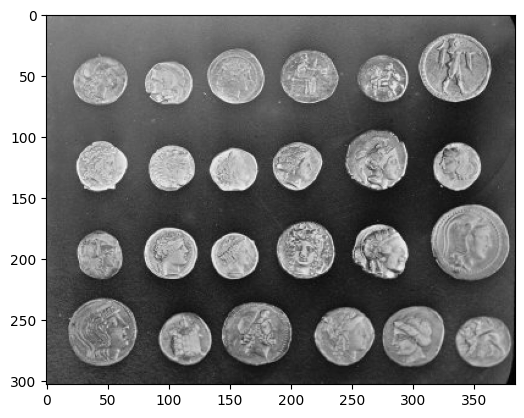

In [55]:
astronaut_image = data.coins()
# astronaut_image = rgb2gray(astronaut_image)
plt.imshow(astronaut_image, cmap='gray')

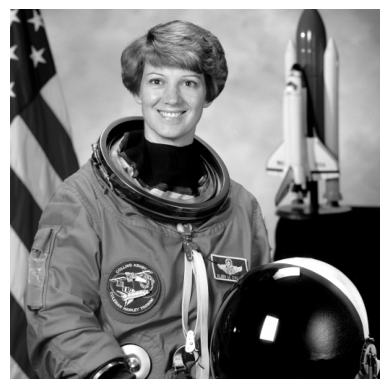

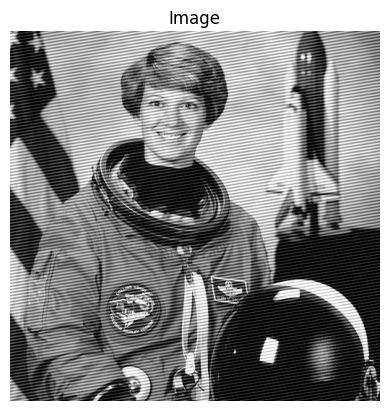

In [56]:
skimage_images = {
    'data.astronaut': rgb2gray(data.astronaut())*255,
    'data.cat': rgb2gray(data.cat())*255,
    'data.coins': data.coins()
}
freq_x = 20
freq_y = 120
amp = 60
plt.imshow(skimage_images['data.astronaut'], cmap='gray')
plt.axis('off')
plt.show()
noised_image = periodic_noise(freq_x, freq_y, amp, skimage_images['data.astronaut'])
plt.imshow(noised_image, cmap='gray')
plt.title(f"Image")
plt.axis('off')
plt.show()

In [57]:
skimage_images = {
    'data.astronaut': rgb2gray(data.astronaut())*255,
    'data.cat': rgb2gray(data.cat())*255,
    'data.coins': data.coins()
}

In [58]:
# sets the probabilities used
freq_values = [0, 5, 10, 15]
amp_values = [0, 15, 60]
freq_values = [0, 10, 20, 30, 40]
amp_values = [0, 20, 40, 60, 80, 100]
exp_values = { # amp, fx, fy
    'no_noise': ([0], [0], [0]),
    'amp': (amp_values, [5], [5]), # experiments with amplitude,
    'fx': ([40], freq_values, [5]), # experiments with frequency
    'fy': ([40], [5], freq_values), # experiments with frequency
}
q_space = np.linspace(-2, 20, num = 23)
q_space = [0]
# stores all the metrics of each image in a list
image_data_list = []
for idx,skimage_name in enumerate(skimage_images):
    gs_image = skimage_images[skimage_name]
    image_title = skimage_name.split('.')[1]
    print(image_title, f"{idx+1}/{len(skimage_images)}")
    for categ in exp_values:
        amp_exp, fx_exp, fy_exp = exp_values[categ]
        for fx_value in fx_exp:
            for fy_value in fy_exp:
                for amp_value in amp_exp:
                    print(f"fx = {fx_value}")
                    print(f"fy = {fy_value}")
                    print(f"amp = {amp_value}")
                    # generate noise image
                    print("Generating noised image")
                    noised_image = periodic_noise(fx_value, fy_value, amp_value, gs_image)
                    # extract metrics
                    print("Extracting data")
                    noised_image_data = get_img_info(noised_image, q_linspace = q_space)
                    # add the information
                    noised_image_data['image_name'] = skimage_name
                    noised_image_data['fx_value'] = fx_value
                    noised_image_data['fy_value'] = fy_value
                    noised_image_data['amp_value'] = amp_value
                    image_data_list.append(noised_image_data)

astronaut 1/3
fx = 0
fy = 0
amp = 0
Generating noised image
Extracting data
fx = 5
fy = 5
amp = 0
Generating noised image
Extracting data
fx = 5
fy = 5
amp = 20
Generating noised image
Extracting data
fx = 5
fy = 5
amp = 40
Generating noised image
Extracting data
fx = 5
fy = 5
amp = 60
Generating noised image
Extracting data
fx = 5
fy = 5
amp = 80
Generating noised image
Extracting data
fx = 5
fy = 5
amp = 100
Generating noised image
Extracting data
fx = 0
fy = 5
amp = 40
Generating noised image
Extracting data
fx = 10
fy = 5
amp = 40
Generating noised image
Extracting data
fx = 20
fy = 5
amp = 40
Generating noised image
Extracting data
fx = 30
fy = 5
amp = 40
Generating noised image
Extracting data
fx = 40
fy = 5
amp = 40
Generating noised image
Extracting data
fx = 5
fy = 0
amp = 40
Generating noised image
Extracting data
fx = 5
fy = 10
amp = 40
Generating noised image
Extracting data
fx = 5
fy = 20
amp = 40
Generating noised image
Extracting data
fx = 5
fy = 30
amp = 40
Generating n

In [60]:
data_default_aux = pd.concat(image_data_list, ignore_index=True)
data_default_aux.to_csv(f"results/noise_analysis/periodic/periodic_analysis_skimage_v2_quali.csv", index = False)

In [32]:
# sets the probabilities used
freq_values = [0, 5, 10, 15]
freq_values = [5]
amp_values = [0, 15, 60]
# stores all the metrics of each image in a list
image_data_list = []
results_image_path = "results/noise_analysis/q0/periodic/images"
for idx,skimage_name in enumerate(skimage_images):
    gs_image = skimage_images[skimage_name]
    image_title = skimage_name.split('.')[1]
    print(image_title, f"{idx+1}/{len(skimage_images)}")
    for fx_value in freq_values:
        for fy_value in freq_values:
            for amp_value in amp_values:
                # if amp_value == 0, just run it once
                if (amp_value == 0) and not ((fx_value == 5) and (fy_value == 5)):
                    continue
                print(f"fx = {fx_value}")
                print(f"fy = {fy_value}")
                print(f"amp = {amp_value}")
                # generate noise image
                print("Generating noised image")
                noised_image = periodic_noise(fx_value, fy_value, amp_value, gs_image)
                # saving
                im = Image.fromarray(noised_image)
                im = im.convert('RGB')
                im.save(f"{results_image_path}/{image_title}-amp-{amp_value}.png")
                

astronaut 1/3
fx = 5
fy = 5
amp = 0
Generating noised image
fx = 5
fy = 5
amp = 15
Generating noised image
fx = 5
fy = 5
amp = 60
Generating noised image
cat 2/3
fx = 5
fy = 5
amp = 0
Generating noised image
fx = 5
fy = 5
amp = 15
Generating noised image
fx = 5
fy = 5
amp = 60
Generating noised image
coins 3/3
fx = 5
fy = 5
amp = 0
Generating noised image
fx = 5
fy = 5
amp = 15
Generating noised image
fx = 5
fy = 5
amp = 60
Generating noised image


### Plotting

In [3]:
image_data = pd.read_csv(f"results/noise_analysis/periodic/periodic_analysis.csv")
image_data_default = pd.read_csv(f"results/noise_analysis/periodic/periodic_analysis_default.csv")
image_data.head()

,q,Smoothness,Curve structure,Weighted Entropy Correct,Weighted Complexity Correct,prob0,prob1,prob2,image_name,fx_value,fy_value,amp_value
0,-2.0,NaN,0.000000,-0.000000,NaN,NaN,0.000000,0.000000,canesugar01-r000-s001.png,5,5,0
1,-1.0,NaN,0.000000,-0.000000,NaN,NaN,0.000000,0.000000,canesugar01-r000-s001.png,5,5,0
2,0.0,0.230972,0.193908,0.932321,0.084523,0.564306,0.314801,0.120893,canesugar01-r000-s001.png,5,5,0
3,1.0,0.311469,0.222770,0.904898,0.120397,0.644803,0.288984,0.066214,canesugar01-r000-s001.png,5,5,0
4,2.0,0.379436,0.225311,0.868004,0.164374,0.712770,0.256271,0.030960,canesugar01-r000-s001.png,5,5,0


In [4]:
filenames = image_data.image_name.unique()
print(filenames)

['canesugar01-r000-s001.png' 'canvas01-r000-s001.png'
 'couscous01-r000-s001.png' 'fabric01-r000-s001.png'
 'fabric02-r000-s001.png' 'fabric03-r000-s001.png'
 'fabric04-r000-s001.png' 'fabric05-r000-s001.png'
 'flaxseed01-r000-s001.png' 'knitwear01-r000-s001.png'
 'knitwear02-r000-s001.png' 'knitwear03-r000-s001.png'
 'lentils01-r000-s001.png' 'oatmeal01-r000-s001.png'
 'pearlsugar01-r000-s001.png' 'rice01-r000-s001.png' 'rug01-r000-s001.png'
 'ryeflakes01-r000-s001.png' 'seeds01-r000-s001.png'
 'seeds02-r000-s001.png' 'sprinkles01-r000-s001.png'
 'tile01-r000-s001.png' 'towel01-r000-s001.png' 'wheat01-r000-s001.png'
 'wool01-r000-s001.png']


In [5]:
# default_data = image_data[(image_data['image_name'] == 'default')]
default_data = image_data_default # pega mais valores de probabilidade de s&p
dataset_data = image_data[image_data['image_name'] != 'default']

In [6]:
print(dataset_data.shape)
dataset_data.head()

(10925, 12)


,q,Smoothness,Curve structure,Weighted Entropy Correct,Weighted Complexity Correct,prob0,prob1,prob2,image_name,fx_value,fy_value,amp_value
0,-2.0,NaN,0.000000,-0.000000,NaN,NaN,0.000000,0.000000,canesugar01-r000-s001.png,5,5,0
1,-1.0,NaN,0.000000,-0.000000,NaN,NaN,0.000000,0.000000,canesugar01-r000-s001.png,5,5,0
2,0.0,0.230972,0.193908,0.932321,0.084523,0.564306,0.314801,0.120893,canesugar01-r000-s001.png,5,5,0
3,1.0,0.311469,0.222770,0.904898,0.120397,0.644803,0.288984,0.066214,canesugar01-r000-s001.png,5,5,0
4,2.0,0.379436,0.225311,0.868004,0.164374,0.712770,0.256271,0.030960,canesugar01-r000-s001.png,5,5,0


Plotting the curve for each noise probability

In [7]:
def truncate(f, n):
    '''Truncates/pads a float f to n decimal places without rounding'''
    s = '{}'.format(f)
    if 'e' in s or 'E' in s:
        return '{0:.{1}f}'.format(f, n)
    i, p, d = s.partition('.')
    return '.'.join([i, (d+'0'*n)[:n]])
truncate(0.05532, 2)

'0.05'

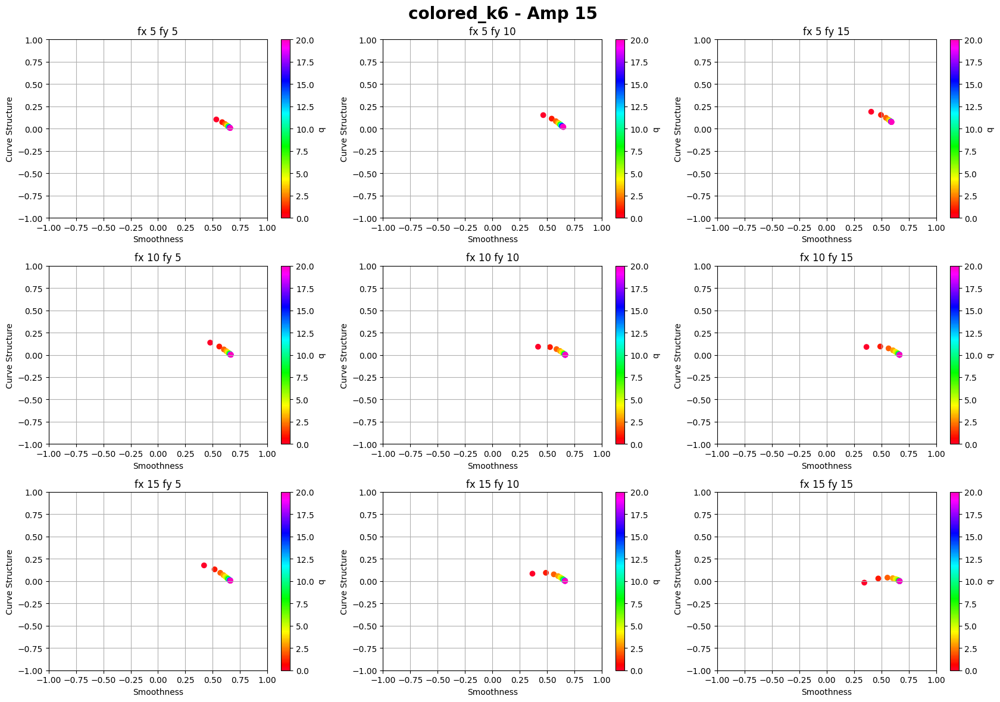

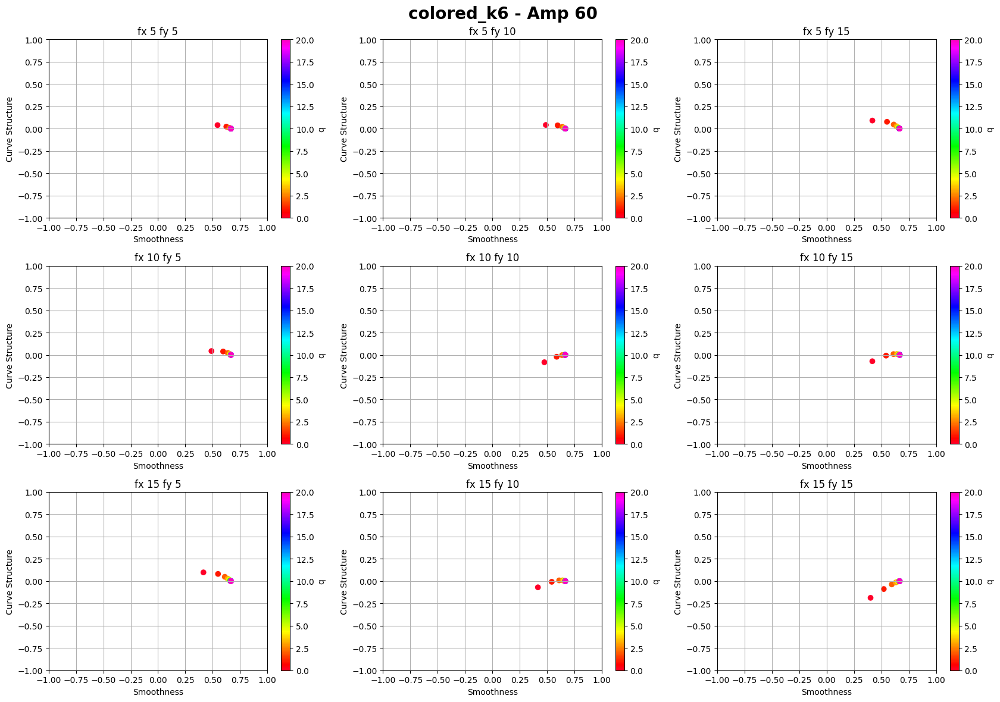

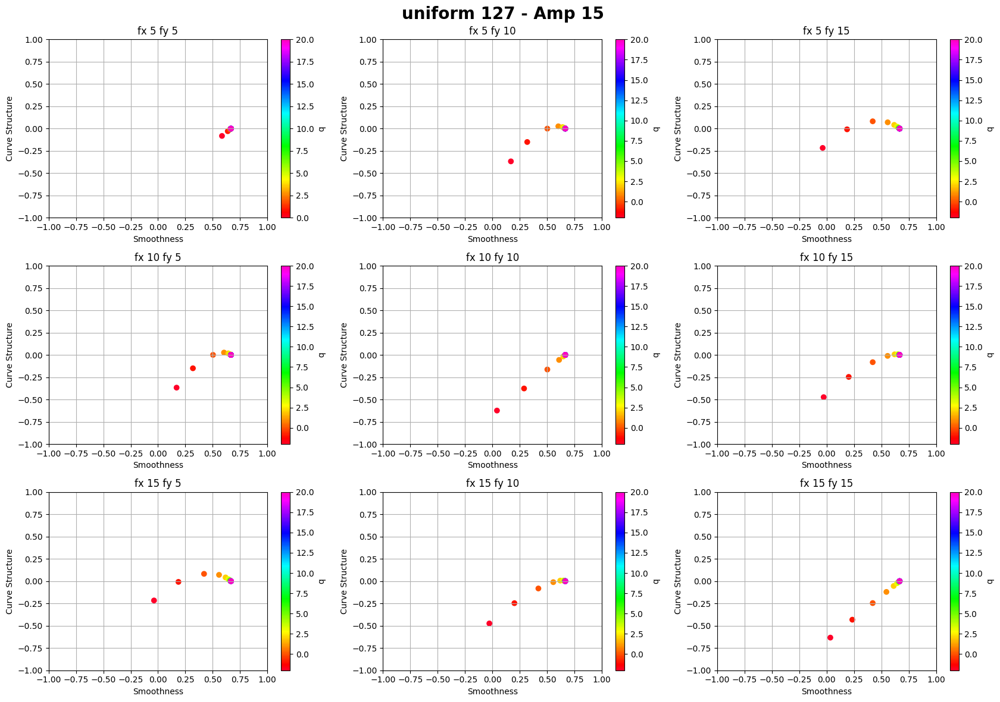

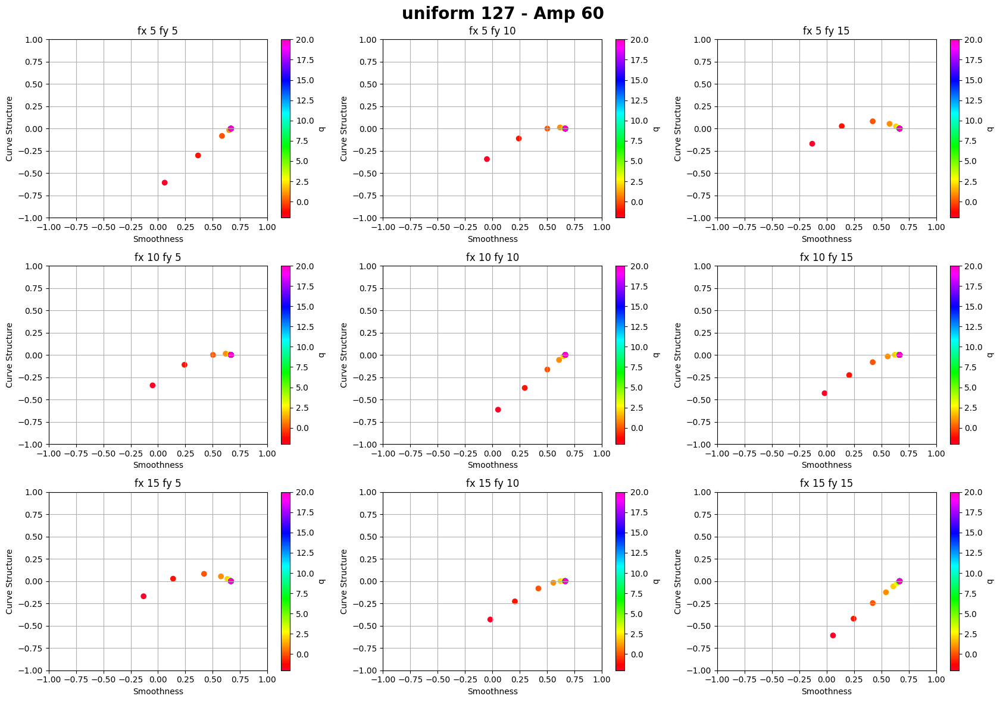

In [147]:
import matplotlib.pyplot as plt
import matplotlib.gridspec as gridspec

unique_default_images = default_data['image_name'].unique()
freq_values = [5, 10, 15]
freq_values_chosen = [5, 10, 15]
amp_values = [15, 60]
amp_values_chosen = amp_values
# Choose some probs to plot
ncolsChosen = len(freq_values_chosen)
nrowsChosen = len(freq_values_chosen)

for i, imageName in enumerate(unique_default_images):
    # Filter DataFrame for the current imagename
    df_data_filtered = default_data[default_data['image_name'] == imageName]


    # iterates over the amp values
    for i_amp, amp_value in enumerate(amp_values):
        fig, axs = plt.subplots(nrows=nrowsChosen, ncols=ncolsChosen, figsize=(17, 4 * nrowsChosen))
        
        for j_fx, fx_value in enumerate(freq_values_chosen):
            for k_fy, fy_value in enumerate(freq_values_chosen):
                # Filter DataFrame for the current noise_prob
                df_filtered = df_data_filtered[(df_data_filtered['amp_value'] == amp_value) & (df_data_filtered['fx_value'] == fx_value) & (df_data_filtered['fy_value'] == fy_value)]

                # Create scatter plot for Smoothness vs. Curve structure, colored by q
                scatter = axs[j_fx][k_fy].scatter(df_filtered['Smoothness'], df_filtered['Curve structure'], 
                                        c=df_filtered['q'], cmap='gist_rainbow')

                # Add colorbar for each subplot
                cbar = fig.colorbar(scatter, ax=axs[j_fx][k_fy])
                cbar.set_label('q')

                # Set title and labels for the subplot
                axs[j_fx][k_fy].set_title(f'fx {fx_value} fy {fy_value}')
                axs[j_fx][k_fy].set_xlabel('Smoothness')
                axs[j_fx][k_fy].set_ylabel('Curve Structure')
                axs[j_fx][k_fy].set_xlim([-1, 1])
                axs[j_fx][k_fy].set_ylim([-1, 1])
                axs[j_fx][k_fy].grid(True)

        plt.suptitle(f"{imageName} - Amp {amp_value}",fontsize=20, fontweight='bold')
        # Adjust layout to prevent overlap
        plt.tight_layout()
        # Save
        plt.savefig(f'results/noise_analysis/periodic/planes/default_{imageName}_amp_{amp_value}.png', bbox_inches='tight')
        # # Show the plot
        # plt.show()

Plotting noise characteristic curve

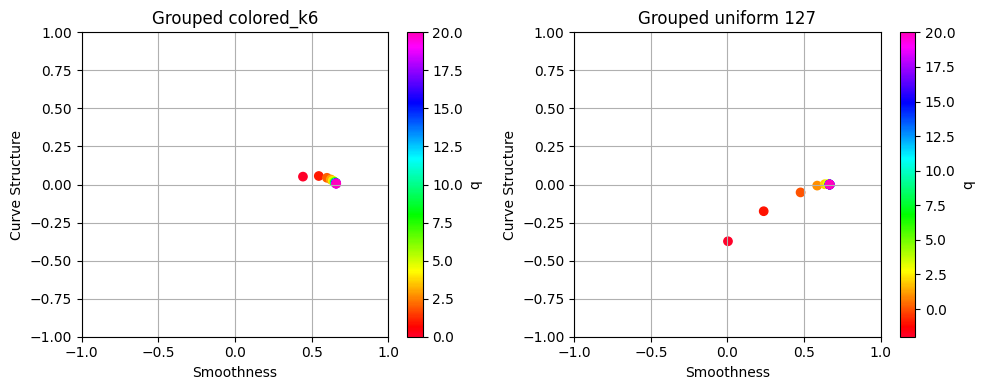

In [146]:
unique_default_images = default_data['image_name'].unique()
ncolsChosen = 2
nrowsChosen = int(np.ceil(len(unique_default_images)/ncolsChosen))
fig, axs = plt.subplots(nrows=nrowsChosen, ncols=ncolsChosen, figsize=(10, 4 * nrowsChosen))

for i, imageName in enumerate(unique_default_images):
    # Filter DataFrame for the current imagename
    df_data_filtered = default_data[default_data['image_name'] == imageName]

    grouped_default = df_data_filtered.groupby('q')[['Smoothness', 'Curve structure', 'Weighted Entropy Correct','Weighted Complexity Correct']].mean()
    grouped_default = grouped_default.reset_index()

    # Create scatter plot for Smoothness vs. Curve structure, colored by q
    scatter = axs[i].scatter(grouped_default['Smoothness'], grouped_default['Curve structure'], 
                             c=grouped_default['q'], cmap='gist_rainbow')

    # Add colorbar for each subplot
    cbar = fig.colorbar(scatter, ax=axs[i])
    cbar.set_label('q')

    # Set title and labels for the subplot
    axs[i].set_title(f'Grouped {imageName}')
    axs[i].set_xlabel('Smoothness')
    axs[i].set_ylabel('Curve Structure')
    axs[i].set_xlim([-1, 1])
    axs[i].set_ylim([-1, 1])
    axs[i].grid(True)

# Adjust layout to prevent overlap
plt.tight_layout()
# Save
plt.savefig(f'results/noise_analysis/periodic/planes/default_grouped.png', bbox_inches='tight')
# Show the plot
plt.show()

Plotting from images

In [9]:
filenames_dataset = dataset_data.image_name.unique()
print(filenames_dataset)

['canesugar01-r000-s001.png' 'canvas01-r000-s001.png'
 'couscous01-r000-s001.png' 'fabric01-r000-s001.png'
 'fabric02-r000-s001.png' 'fabric03-r000-s001.png'
 'fabric04-r000-s001.png' 'fabric05-r000-s001.png'
 'flaxseed01-r000-s001.png' 'knitwear01-r000-s001.png'
 'knitwear02-r000-s001.png' 'knitwear03-r000-s001.png'
 'lentils01-r000-s001.png' 'oatmeal01-r000-s001.png'
 'pearlsugar01-r000-s001.png' 'rice01-r000-s001.png' 'rug01-r000-s001.png'
 'ryeflakes01-r000-s001.png' 'seeds01-r000-s001.png'
 'seeds02-r000-s001.png' 'sprinkles01-r000-s001.png'
 'tile01-r000-s001.png' 'towel01-r000-s001.png' 'wheat01-r000-s001.png'
 'wool01-r000-s001.png']


['flaxseed01-r000-s001.png' 'wool01-r000-s001.png'
 'fabric04-r000-s001.png' 'fabric01-r000-s001.png' 'seeds02-r000-s001.png'
 'knitwear03-r000-s001.png' 'towel01-r000-s001.png'
 'pearlsugar01-r000-s001.png' 'rug01-r000-s001.png'
 'canvas01-r000-s001.png' 'couscous01-r000-s001.png'
 'tile01-r000-s001.png' 'oatmeal01-r000-s001.png'
 'sprinkles01-r000-s001.png' 'lentils01-r000-s001.png'
 'fabric03-r000-s001.png' 'knitwear01-r000-s001.png'
 'fabric02-r000-s001.png' 'rice01-r000-s001.png' 'fabric05-r000-s001.png'
 'seeds01-r000-s001.png' 'ryeflakes01-r000-s001.png'
 'knitwear02-r000-s001.png' 'canesugar01-r000-s001.png'
 'wheat01-r000-s001.png']


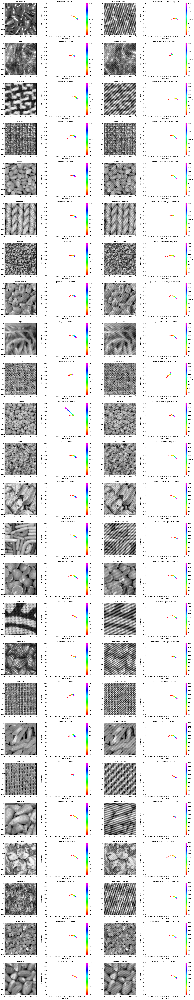

In [156]:
freq_values = [5, 10, 15]
amp_values = [0, 15, 60] # don want amp=0
amp_values = [15, 60]
amountOfImages = 25 # must be less or equal to 25
ncolsChosen = 4
chosen_filenames = np.random.choice(filenames_dataset, amountOfImages, replace=False)
print(chosen_filenames)
# nrowsChosen = int(np.ceil(len(chosen_filenames)/ncolsChosen))
nrowsChosen = amountOfImages
fig, axs = plt.subplots(nrows=nrowsChosen, ncols=ncolsChosen, figsize=(20, 4* nrowsChosen))
# Flatten the axs array for easier indexing
# axs = axs.flatten()
images_path = f'data/Sintorn/hardware'
for i, imageName in enumerate(chosen_filenames):
    # read image
    img_filename = images_filenames[3]
    gs_image = cv2.imread(f'{images_path}/{imageName}', cv2.IMREAD_GRAYSCALE)
    # pick a fx, fy amp
    fx_chosen = np.random.choice(freq_values)
    fy_chosen = np.random.choice(freq_values)
    amp_chosen = np.random.choice(amp_values)

    #noised image
    noised_image = periodic_noise(fx_chosen, fy_chosen, amp_chosen, gs_image)

    # Filter DataFrame for the current imageName and probability
    df_filtered = image_data[(image_data['image_name'] == imageName) & (image_data['fx_value'] == fx_chosen) & (image_data['fy_value'] == fy_value) & (image_data['amp_value'] == amp_chosen)]
    # no noise fx=fy=5 and amp=0 (only executed for fx=fy=5)
    df_filtered_no_noise = image_data[(image_data['image_name'] == imageName) & (image_data['fx_value'] == 5) & (image_data['fy_value'] == 5) & (image_data['amp_value'] == 0)]


    # Create scatter plot for Smoothness vs. Curve structure, colored by q
    axs[i][0].imshow(gs_image, cmap='gray')
    scatter = axs[i][1].scatter(df_filtered_no_noise['Smoothness'], df_filtered_no_noise['Curve structure'], 
                             c=df_filtered_no_noise['q'], cmap='gist_rainbow')
    axs[i][2].imshow(noised_image, cmap='gray')
    scatter = axs[i][3].scatter(df_filtered['Smoothness'], df_filtered['Curve structure'], 
                             c=df_filtered['q'], cmap='gist_rainbow')

    axs[i][0].set_title(f"{imageName.split('-')[0]}")
    axs[i][2].set_title(f"{imageName.split('-')[0]} Noised")
    for j in [1, 3]:

        # Add colorbar for each subplot
        cbar = fig.colorbar(scatter, ax=axs[i][j])
        cbar.set_label('q')
        # Set title and labels for the subplot
        axs[i][j].set_title(f"{imageName.split('-')[0]} {f'fx={fx_chosen} fy={fy_chosen} amp={amp_chosen}' if (j==3) else 'No Noise'}")
        axs[i][j].set_xlabel('Smoothness')
        axs[i][j].set_ylabel('Curve Structure')
        axs[i][j].set_xlim([-1, 1])
        axs[i][j].set_ylim([-1, 1])
        axs[i][j].grid(True)
# Adjust layout to prevent overlap
plt.tight_layout()
# Save
plt.savefig(f'results/noise_analysis/periodic/planes/periodic_dataset_sample_comparing_v2.png', bbox_inches='tight')
# Show the plot
plt.show()

['couscous01-r000-s001.png' 'fabric03-r000-s001.png'
 'tile01-r000-s001.png' 'lentils01-r000-s001.png' 'wheat01-r000-s001.png'
 'canvas01-r000-s001.png' 'fabric01-r000-s001.png' 'seeds02-r000-s001.png'
 'towel01-r000-s001.png' 'wool01-r000-s001.png' 'flaxseed01-r000-s001.png'
 'seeds01-r000-s001.png' 'fabric04-r000-s001.png'
 'ryeflakes01-r000-s001.png' 'rice01-r000-s001.png' 'rug01-r000-s001.png'
 'fabric02-r000-s001.png' 'sprinkles01-r000-s001.png'
 'canesugar01-r000-s001.png' 'knitwear01-r000-s001.png'
 'knitwear02-r000-s001.png' 'pearlsugar01-r000-s001.png'
 'oatmeal01-r000-s001.png' 'fabric05-r000-s001.png'
 'knitwear03-r000-s001.png']


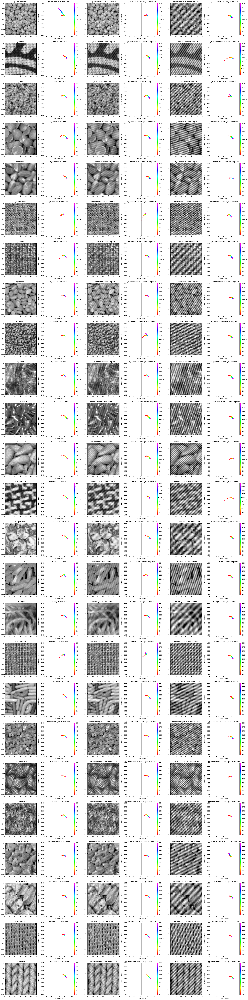

In [22]:
freq_values = [5, 10, 15]
amp_values = [0, 15, 60] # don want amp=0
amp_values = [15, 60]
amountOfImages = 25 # must be less or equal to 25
ncolsChosen = 6
chosen_filenames = np.random.choice(filenames_dataset, amountOfImages, replace=False)
print(chosen_filenames)
# nrowsChosen = int(np.ceil(len(chosen_filenames)/ncolsChosen))
nrowsChosen = amountOfImages
fig, axs = plt.subplots(nrows=nrowsChosen, ncols=ncolsChosen, figsize=(25, 4*nrowsChosen))
# Flatten the axs array for easier indexing
# axs = axs.flatten()
images_path = f'data/Sintorn/hardware'
for i, imageName in enumerate(chosen_filenames):
    # read image
    gs_image = cv2.imread(f'{images_path}/{imageName}', cv2.IMREAD_GRAYSCALE)
    # pick a fx, fy amp
    fx_chosen = np.random.choice(freq_values)
    fy_chosen = np.random.choice(freq_values)
    # amp_chosen = np.random.choice(amp_values)

    # no noise fx=fy=5 and amp=0 (only executed for fx=fy=5)
    df_filtered_no_noise = image_data[(image_data['image_name'] == imageName) & (image_data['fx_value'] == 5) & (image_data['fy_value'] == 5) & (image_data['amp_value'] == 0)]
    # plots no noise image and plot
    axs[i][0].imshow(gs_image, cmap='gray')
    scatter = axs[i][1].scatter(df_filtered_no_noise['Smoothness'], df_filtered_no_noise['Curve structure'], 
                             c=df_filtered_no_noise['q'], cmap='gist_rainbow')
    axs[i][0].set_title(f"({i+1})-{imageName.split('-')[0]}")
    scatter_idxs = [(1, 0)]
    for idx, amp_chosen in enumerate(amp_values):
        #noised image
        noised_image = periodic_noise(fx_chosen, fy_chosen, amp_chosen, gs_image)
        # Filter DataFrame for the current imageName and probability
        df_filtered = image_data[(image_data['image_name'] == imageName) & (image_data['fx_value'] == fx_chosen) & (image_data['fy_value'] == fy_chosen) & (image_data['amp_value'] == amp_chosen)]
        # Create scatter plot for Smoothness vs. Curve structure, colored by q
        axs[i][2+idx*2].imshow(noised_image, cmap='gray')
        scatter = axs[i][3+idx*2].scatter(df_filtered['Smoothness'], df_filtered['Curve structure'], 
                                c=df_filtered['q'], cmap='gist_rainbow')
    
        axs[i][2+idx*2].set_title(f"({i+1})-{imageName.split('-')[0]} Noised Amp {amp_chosen}")
        scatter_idxs.append((3+idx*2, amp_chosen))
    for j, amp_chosen in scatter_idxs:

        # Add colorbar for each subplot
        cbar = fig.colorbar(scatter, ax=axs[i][j])
        cbar.set_label('q')
        # Set title and labels for the subplot
        axs[i][j].set_title(f"({i+1})-{imageName.split('-')[0]} {'No Noise' if (j==1) else f'fx={fx_chosen} fy={fy_chosen} amp={amp_chosen}'}")
        axs[i][j].set_xlabel('Smoothness')
        axs[i][j].set_ylabel('Curve Structure')
        axs[i][j].set_xlim([-1, 1])
        axs[i][j].set_ylim([-1, 1])
        axs[i][j].grid(True)
# Adjust layout to prevent overlap
plt.tight_layout()
# Save
plt.savefig(f'results/noise_analysis/periodic/planes/periodic_dataset_sample_comparing_v3.png', bbox_inches='tight')
# Show the plot
plt.show()